In [1]:
import json
import pandas as pd
import os
path = "C:/Users/cibei/OneDrive/Desktop/congress_tweets/congresstweets/data/historical-users-filtered.json"
from scripts.tweets_retrieving import extract_members_from_data, process_tweets_range
from scripts.classify_emotions import EmotionClassifier
from scripts.plots import *


c:\Users\cibei\OneDrive\Desktop\congress_tweets\venv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
members_df = extract_members_from_data(path)

Members extracted: 744


In [3]:
'''before_df = process_tweets_range(
    data_dir="./congresstweets/data",
    members_df=members_df,
    date_range=("2021-01-02", "2021-01-05"),
    output_dir="./df_clean/"
)

after_df = process_tweets_range(
    data_dir="./congresstweets/data",
    members_df=members_df,
    date_range=("2021-01-07", "2021-01-10"),
    output_dir="./df_clean/"
)
df_riot_window = process_tweets_range(
    data_dir="./congresstweets/data",
    members_df=members_df,
    date_range=("2021-01-06", "2021-01-07"),
    hour_range=(19, 5),  # UTC equivalent of 14–24 EST
    output_dir="./df_clean/"
)

df_before_riot = process_tweets_range(
    data_dir="./congresstweets/data",
    members_df=members_df,
    date_range=("2021-01-05", "2021-01-06"),  # includes both Jan 5 and 6
    hour_range=(19, 19),  # from 19:00 on Jan 5 to 19:00 on Jan 6 (UTC)
    output_dir="./df_clean/"
)
df_after_riot = process_tweets_range(
    data_dir="./congresstweets/data",
    members_df=members_df,
    date_range=("2021-01-07", "2021-01-08"),  # includes Jan 7 and 8
    hour_range=(5, 5),  # from 05:00 on Jan 7 to 05:00 on Jan 8 (UTC)
    output_dir="./df_clean/"
)


#If you want to run the above code, uncomment it.
# Load the processed DataFrames
before_df = pd.read_csv("./df_clean/tweets_2020-12-01_2021-01-05.csv")
after_df = pd.read_csv("./df_clean/tweets_2021-01-06_2021-02-15.csv")
df_riot_window = pd.read_csv("./df_clean/tweets_2021-01-06_2021-01-07_19to5.csv")
df_before_riot = pd.read_csv("./df_clean/tweets_2021-01-05_2021-01-06_19to19.csv")
df_after_riot = pd.read_csv("./df_clean/tweets_2021-01-07_2021-01-08_5to5.csv")
'''


'before_df = process_tweets_range(\n    data_dir="./congresstweets/data",\n    members_df=members_df,\n    date_range=("2021-01-02", "2021-01-05"),\n    output_dir="./df_clean/"\n)\n\nafter_df = process_tweets_range(\n    data_dir="./congresstweets/data",\n    members_df=members_df,\n    date_range=("2021-01-07", "2021-01-10"),\n    output_dir="./df_clean/"\n)\ndf_riot_window = process_tweets_range(\n    data_dir="./congresstweets/data",\n    members_df=members_df,\n    date_range=("2021-01-06", "2021-01-07"),\n    hour_range=(19, 5),  # UTC equivalent of 14–24 EST\n    output_dir="./df_clean/"\n)\n\ndf_before_riot = process_tweets_range(\n    data_dir="./congresstweets/data",\n    members_df=members_df,\n    date_range=("2021-01-05", "2021-01-06"),  # includes both Jan 5 and 6\n    hour_range=(19, 19),  # from 19:00 on Jan 5 to 19:00 on Jan 6 (UTC)\n    output_dir="./df_clean/"\n)\ndf_after_riot = process_tweets_range(\n    data_dir="./congresstweets/data",\n    members_df=members_df,

In [4]:
import torch
print(torch.cuda.is_available())
print(torch.cuda.get_device_name(0))

True
NVIDIA GeForce GTX 1650 with Max-Q Design


In [5]:
emotion_group_map = {
    # Fear-based appeals (used to warn, alarm, or manipulate)
    "fear": "fear",
    "nervousness": "fear",

    # Anger-based framing (used to attack, blame, provoke)
    "anger": "anger",
    "annoyance": "anger",
    "disapproval": "anger",

    # Sadness-based framing (used for grief, mourning, moral injury)
    "grief": "sadness",
    "disappointment": "sadness",
    "remorse": "sadness",
    "sadness": "sadness",

    # Joy-based framing (used for victory, pride, unity, celebration)
    "admiration": "joy",
    "amusement": "joy",
    "approval": "joy",
    "excitement": "joy",
    "gratitude": "joy",
    "joy": "joy",
    "love": "joy",
    "optimism": "joy",
    "pride": "pride",  # keep separate to detect nationalism/partisan pride
    "relief": "joy",

    # Surprise-based (used to express shock, reaction, or awakening)
    "confusion": "surprise",
    "curiosity": "surprise",
    "realization": "surprise",
    "surprise": "surprise",

    # Manipulative / Other-oriented (used for persuasion, unity, moral stance)
    "caring": "moral",
    "desire": "moral",
    "embarrassment": "moral",

    # Disgust (potentially moral disgust or vilification)
    "disgust": "disgust",

    # Neutral statements
    "neutral": "neutral"
}


In [6]:
# Initialize
emo = EmotionClassifier(emotion_map=emotion_group_map)

Device set to use cuda:0


In [7]:
'''before_df = emo.classify_and_save(
    df=before_df,
    save_path="./df_with_emotions/days_4_before_riot.csv",
    k=1
)

after_df = emo.classify_and_save(
    df=after_df,
    save_path="./df_with_emotions/days_4_after_riot.csv",
    k=1
)

df_riot_window = emo.classify_and_save(
    df=df_riot_window,
    save_path="./df_with_emotions/during_riot.csv",
    k=1
)

df_before_riot = emo.classify_and_save(
    df=df_before_riot,
    save_path="./df_with_emotions/days_1_before_riot.csv",
    k=1
)

df_after_riot = emo.classify_and_save(
    df=df_after_riot,
    save_path="./df_with_emotions/days_1_after_riot.csv",
    k=1
)
'''



'before_df = emo.classify_and_save(\n    df=before_df,\n    save_path="./df_with_emotions/days_4_before_riot.csv",\n    k=1\n)\n\nafter_df = emo.classify_and_save(\n    df=after_df,\n    save_path="./df_with_emotions/days_4_after_riot.csv",\n    k=1\n)\n\ndf_riot_window = emo.classify_and_save(\n    df=df_riot_window,\n    save_path="./df_with_emotions/during_riot.csv",\n    k=1\n)\n\ndf_before_riot = emo.classify_and_save(\n    df=df_before_riot,\n    save_path="./df_with_emotions/days_1_before_riot.csv",\n    k=1\n)\n\ndf_after_riot = emo.classify_and_save(\n    df=df_after_riot,\n    save_path="./df_with_emotions/days_1_after_riot.csv",\n    k=1\n)\n'

In [8]:
# upload the dataframes from the repo
before_df = pd.read_csv("./df_with_emotions/days_4_before_riot.csv")
print(before_df.shape)
after_df = pd.read_csv("./df_with_emotions/days_4_after_riot.csv")
print(after_df.shape)
df_riot_window = pd.read_csv("./df_with_emotions/during_riot.csv") 
print(df_riot_window.shape)
df_before_riot = pd.read_csv("./df_with_emotions/days_1_before_riot.csv")
print(df_before_riot.shape)
df_after_riot = pd.read_csv("./df_with_emotions/days_1_after_riot.csv")
print(df_after_riot.shape)

(3251, 14)
(4154, 14)
(1221, 14)
(1346, 14)
(1551, 14)


# Macro-analysis

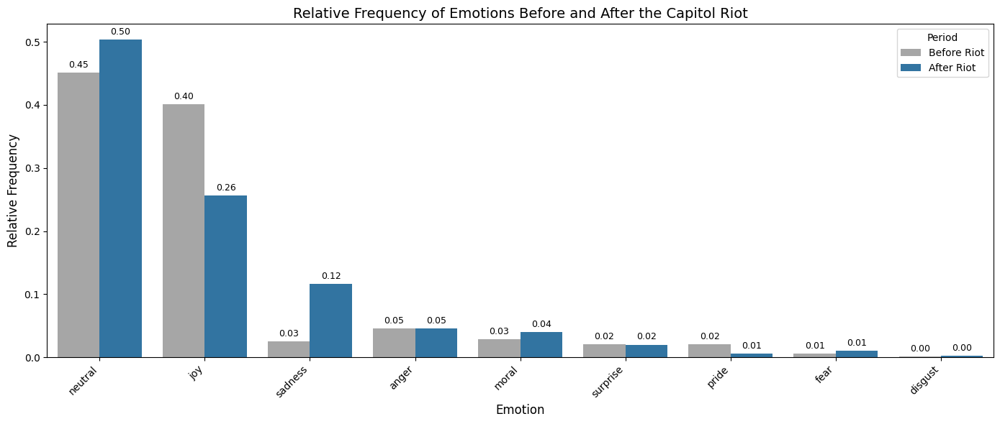

,grouped_emotion,relative_frequency,Period
0,neutral,0.451553,Before Riot
1,joy,0.400800,Before Riot
2,anger,0.045217,Before Riot
3,moral,0.028914,Before Riot
4,sadness,0.025531,Before Riot
5,surprise,0.020301,Before Riot
6,pride,0.020301,Before Riot
7,fear,0.006152,Before Riot
8,disgust,0.001230,Before Riot
9,neutral,0.503130,After Riot


In [9]:
plot_emotion_distribution_change(
    period_dfs={
        "Before Riot": before_df,
        "After Riot": after_df,
    },
    column="emotion_group",
    title="Relative Frequency of Emotions Before and After the Capitol Riot"
)



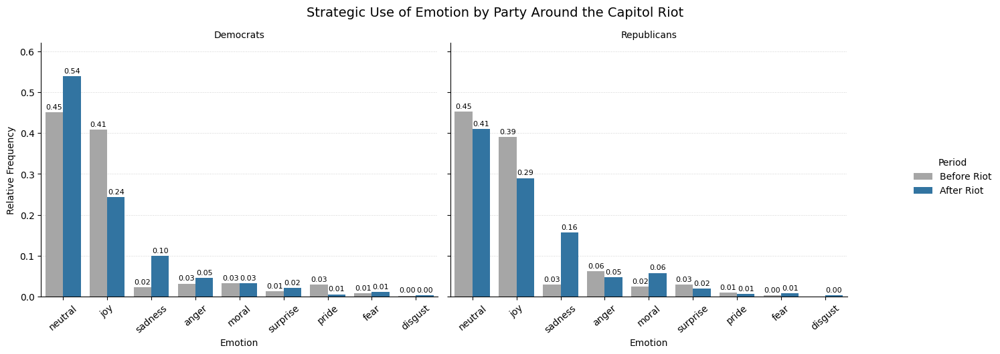

,Party,Period,Emotion,count,relative_frequency
0,Democrats,Before Riot,neutral,816,0.451078
1,Democrats,Before Riot,joy,740,0.409066
2,Democrats,Before Riot,sadness,41,0.022664
3,Democrats,Before Riot,anger,57,0.031509
4,Democrats,Before Riot,moral,59,0.032615
5,Democrats,Before Riot,surprise,24,0.013267
6,Democrats,Before Riot,pride,53,0.029298
7,Democrats,Before Riot,fear,15,0.008292
8,Democrats,Before Riot,disgust,4,0.002211
9,Democrats,After Riot,neutral,1607,0.539624


In [10]:
plot_emotions_by_party_and_period(
    period_dfs={
        "Before Riot": before_df,
        "After Riot": after_df
    },
    column="emotion_group",
    title="Strategic Use of Emotion by Party Around the Capitol Riot"
)



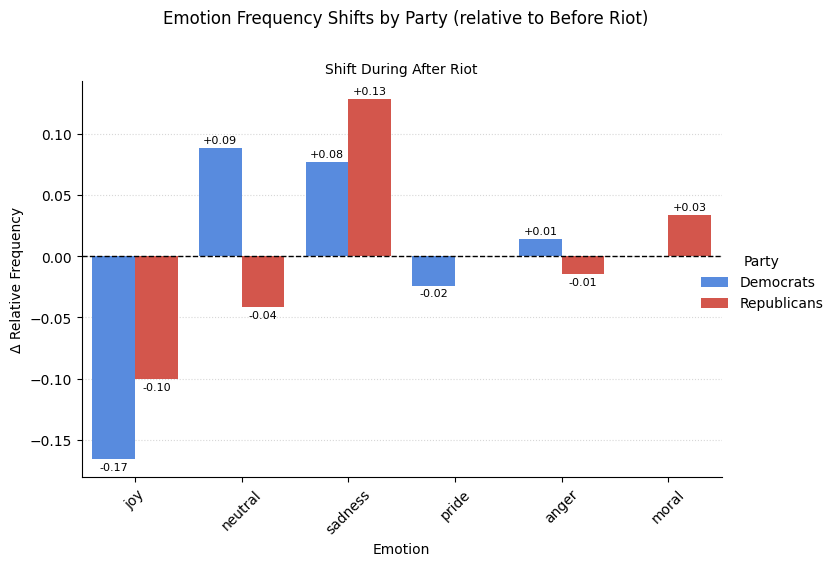

Period,Party,Emotion,Delta,DeltaPeriod
0,Democrats,joy,-0.165614,After Riot
1,Democrats,neutral,0.088546,After Riot
2,Democrats,sadness,0.076731,After Riot
3,Democrats,pride,-0.023925,After Riot
4,Democrats,anger,0.013823,After Riot
5,Republicans,sadness,0.128187,After Riot
6,Republicans,joy,-0.100464,After Riot
7,Republicans,neutral,-0.041436,After Riot
8,Republicans,moral,0.033551,After Riot
9,Republicans,anger,-0.014794,After Riot


In [11]:
plot_emotion_shift_by_party(
    period_dfs={
        "Before Riot": before_df,
        "After Riot": after_df
    },
    column="emotion_group",
    reference_period="Before Riot",
    top_n=5
)



# Micro analysis

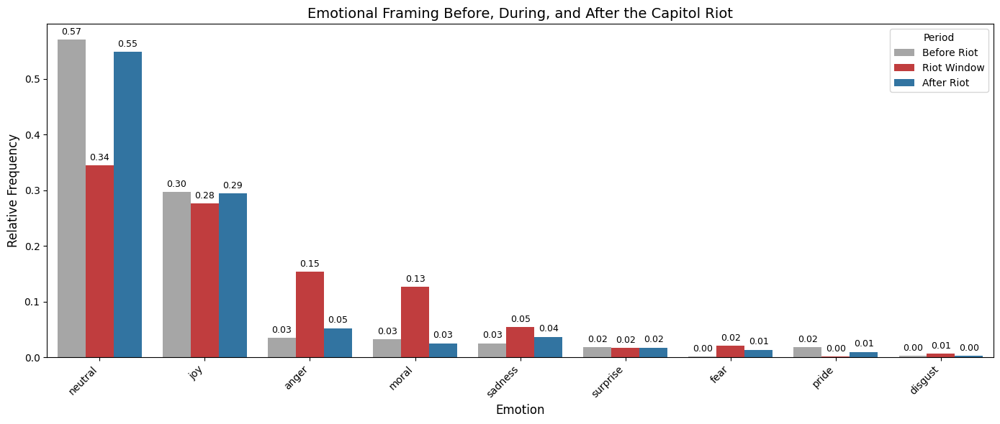

,grouped_emotion,relative_frequency,Period
0,neutral,0.569837,Before Riot
1,joy,0.297177,Before Riot
2,anger,0.034918,Before Riot
3,moral,0.032689,Before Riot
4,sadness,0.025260,Before Riot
5,surprise,0.018574,Before Riot
6,pride,0.017831,Before Riot
7,disgust,0.002229,Before Riot
8,fear,0.001486,Before Riot
9,neutral,0.344799,Riot Window


In [12]:
plot_emotion_distribution_change(
    period_dfs={
        "Before Riot": df_before_riot,
        "Riot Window": df_riot_window,
        "After Riot": df_after_riot
    },
    column="emotion_group",
    title="Emotional Framing Before, During, and After the Capitol Riot"
)


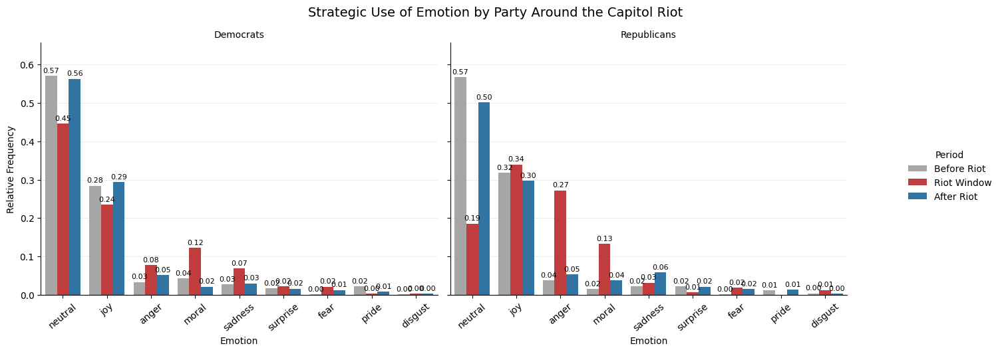

,Party,Period,Emotion,count,relative_frequency
0,Democrats,Before Riot,neutral,478,0.571087
1,Democrats,Before Riot,joy,238,0.284349
2,Democrats,Before Riot,anger,28,0.033453
3,Democrats,Before Riot,moral,36,0.043011
4,Democrats,Before Riot,sadness,23,0.027479
5,Democrats,Before Riot,surprise,14,0.016726
6,Democrats,Before Riot,fear,1,0.001195
7,Democrats,Before Riot,pride,18,0.021505
8,Democrats,Before Riot,disgust,1,0.001195
9,Democrats,Riot Window,neutral,333,0.445783


In [13]:
plot_emotions_by_party_and_period(
    period_dfs={
        "Before Riot": df_before_riot,
        "Riot Window": df_riot_window,
        "After Riot": df_after_riot
    },
    column="emotion_group",
    title="Strategic Use of Emotion by Party Around the Capitol Riot"
)


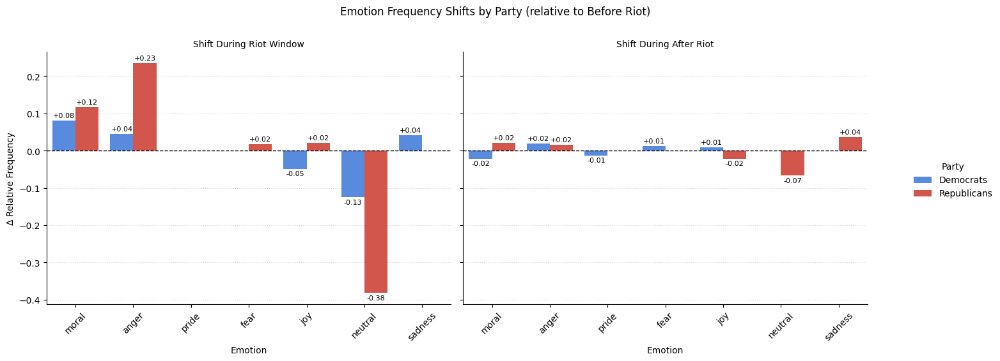

Period,Party,Emotion,Delta,DeltaPeriod
0,Democrats,moral,-0.021716,After Riot
1,Democrats,anger,0.018506,After Riot
2,Democrats,pride,-0.012987,After Riot
3,Democrats,fear,0.011582,After Riot
4,Democrats,joy,0.009518,After Riot
5,Democrats,neutral,-0.125304,Riot Window
6,Democrats,moral,0.080149,Riot Window
7,Democrats,joy,-0.048740,Riot Window
8,Democrats,anger,0.044191,Riot Window
9,Democrats,sadness,0.040794,Riot Window


In [14]:
plot_emotion_shift_by_party(
    period_dfs={
        "Before Riot": df_before_riot,
        "Riot Window": df_riot_window,
        "After Riot": df_after_riot
    },
    column="emotion_group",
    reference_period="Before Riot",
    top_n=5
)


# Pelosi and McCarthy analysis after riot

In [15]:
# Pelosi tweets
pelosi_during = df_riot_window[df_riot_window["screen_name"] == "speakerpelosi"].copy()
pelosi_after  = df_after_riot[df_after_riot["screen_name"] == "speakerpelosi"].copy()

# Cheney tweets
mccarthy_during = df_riot_window[df_riot_window["screen_name"] == "gopleader"].copy()
mccarthy_after  = df_after_riot[df_after_riot["screen_name"] == "gopleader"].copy()
#Counts the rows in each DataFrame
print(f"Pelosi During Riot: {len(pelosi_during)} tweets")
print(f"Pelosi After Riot: {len(pelosi_after)} tweets")
print(f"McCarthy During Riot: {len(mccarthy_during)} tweets")
print(f"McCarthy After Riot: {len(mccarthy_after)} tweets")


Pelosi During Riot: 1 tweets
Pelosi After Riot: 2 tweets
McCarthy During Riot: 3 tweets
McCarthy After Riot: 2 tweets



Analyzing: . and I are calling on President Trump to demand that all protestors leave the U.S. Capitol and Capitol grounds immediately.



RobertaSdpaSelfAttention is used but `torch.nn.functional.scaled_dot_product_attention` does not support non-absolute `position_embedding_type` or `output_attentions=True` or `head_mask`. Falling back to the manual attention implementation, but specifying the manual implementation will be required from Transformers version v5.0.0 onwards. This warning can be removed using the argument `attn_implementation="eager"` when loading the model.


Top predicted emotions:
  neutral → neutral: 0.964
  approval → joy: 0.009
  annoyance → anger: 0.008
  desire → moral: 0.006
  disapproval → anger: 0.002


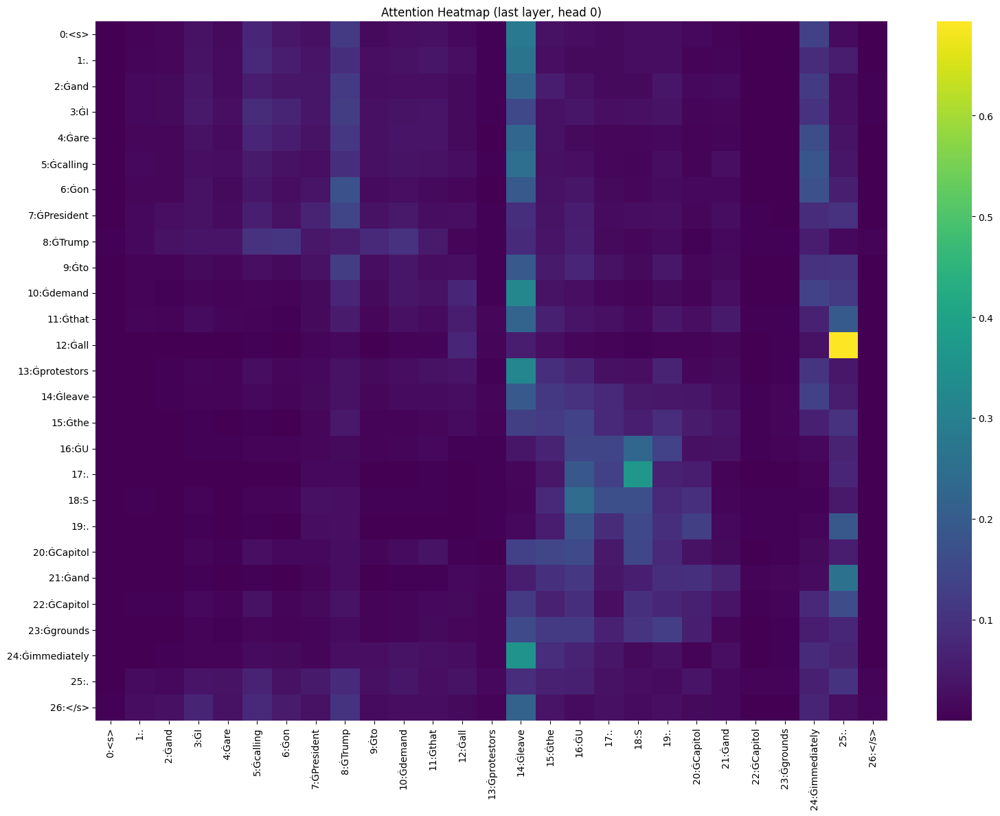


Running SHAP explainability...


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
PartitionExplainer explainer: 2it [00:15, 15.98s/it]               


In [16]:
emo.analyze_with_attention(pelosi_during.iloc[0]["text"])


Analyzing: What is unfolding is unacceptable and un-American. It has got to stop.

Top predicted emotions:
  disapproval → anger: 0.826
  annoyance → anger: 0.084
  neutral → neutral: 0.034
  anger → anger: 0.018
  approval → joy: 0.009


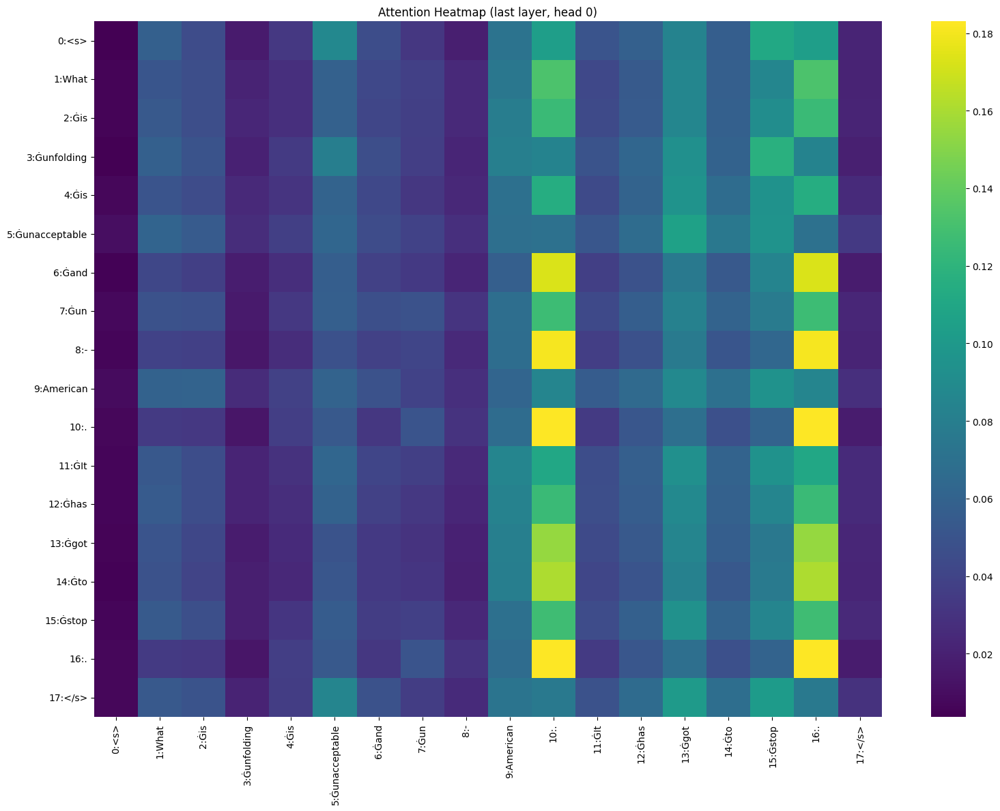


Running SHAP explainability...


In [17]:

emo.analyze_with_attention(mccarthy_during.iloc[0]["text"])


Analyzing: Yesterday, American democracy came under attack — but we refuse to be bullied into abandoning our duty to work #ForThePeople.

Top predicted emotions:
  disapproval → anger: 0.353
  neutral → neutral: 0.289
  disappointment → sadness: 0.117
  approval → joy: 0.073
  annoyance → anger: 0.055


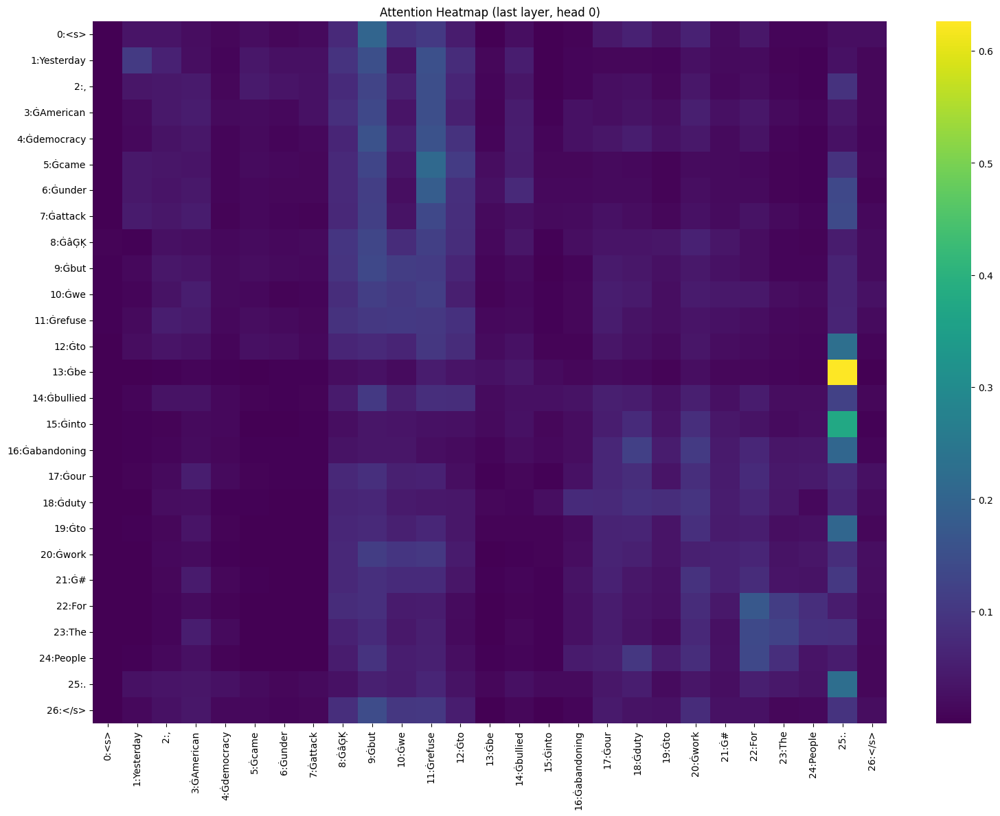


Running SHAP explainability...


In [18]:
emo.analyze_with_attention(pelosi_after.iloc[0]["text"])


Analyzing: The violent mob responsible for this attack on the U.S. Capitol deserves the full consequences of their actions under the law. The FBI is seeking to identify individuals instigating violence in Washington, D.C. We are accepting tips and digital media depicting rioting or violence in and around the U.S. Capitol on January 6. If you have information, visit

Top predicted emotions:
  neutral → neutral: 0.953
  approval → joy: 0.023
  desire → moral: 0.005
  curiosity → surprise: 0.003
  optimism → joy: 0.003


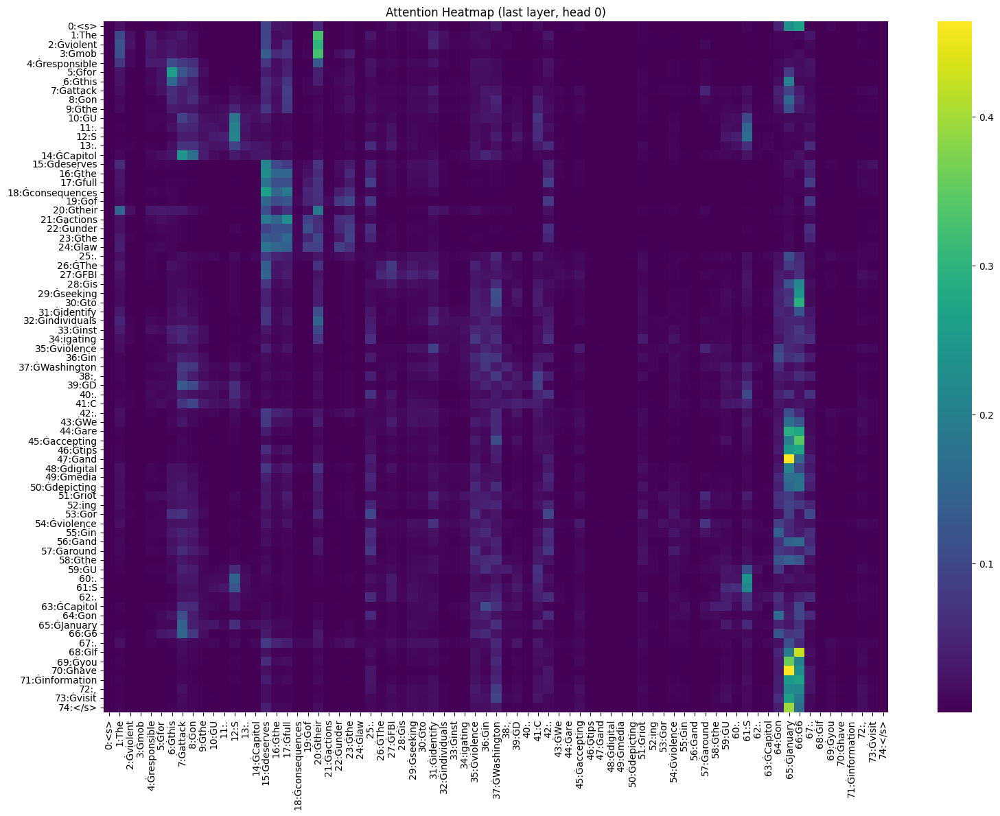


Running SHAP explainability...


In [19]:
emo.analyze_with_attention(mccarthy_after.iloc[0]["text"])